# <font color = 'orange'> Visualize 

---

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import os

In [5]:
df = pd.read_pickle('E:/PW Skills - Data Science/04_Machine_Learning/Week_ML_Projects/04_Fitness_Tracker/data/interim/01_processed_data.pkl')

In [7]:
df.head()

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30


---

### <font color='blue'> Plot single columns

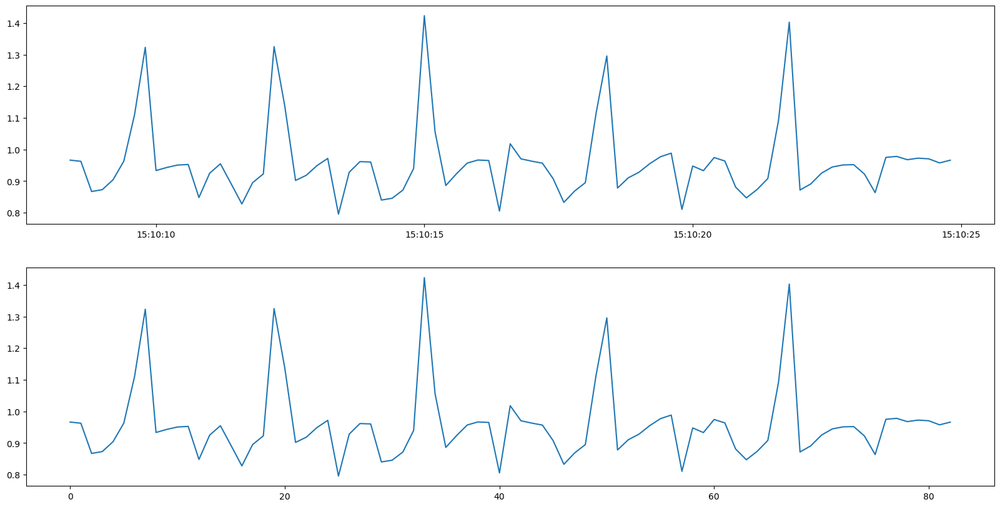

In [10]:
set_df = df[ df['set'] == 1 ]

fig, ax = plt.subplots(nrows = 2, figsize = (20, 10))

ax[0].plot(set_df['acc_y'])
# **observation**: unable to see the number of samples

ax[1].plot(set_df.reset_index()['acc_y'])
# **observation**: we can see there are 80 samples

---

### <font color='blue'> Plot all exercises

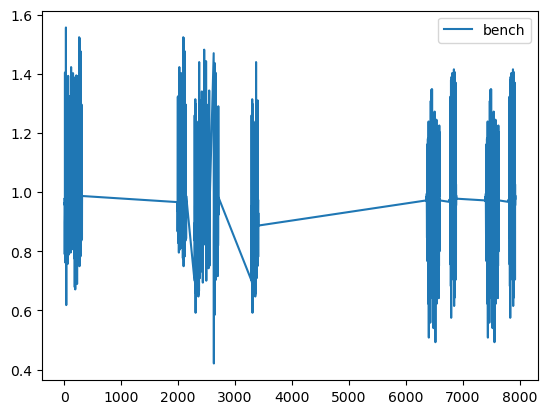

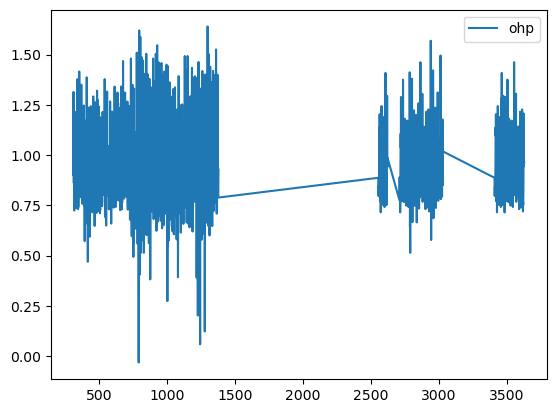

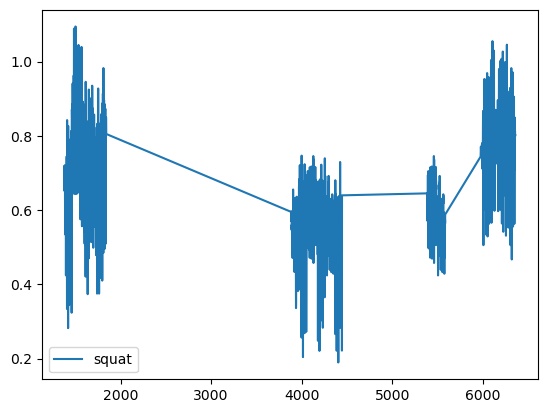

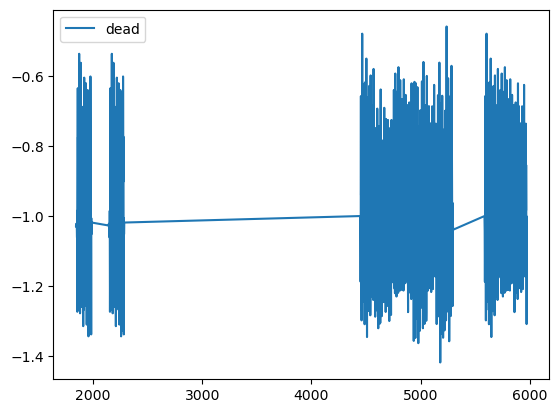

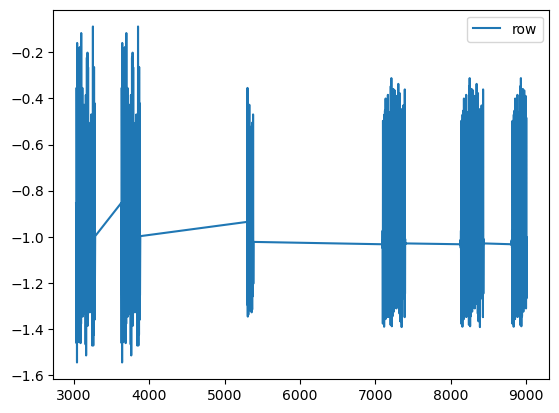

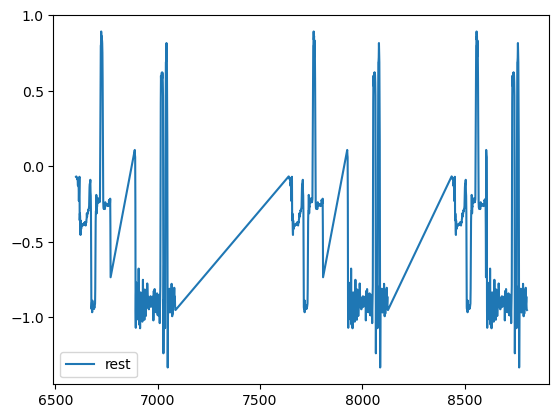

In [12]:
temp_df = df.reset_index()

for exercise in temp_df['label'].unique():
    subset_df = temp_df[ temp_df['label'] == exercise ]
    fig, ax = plt.subplots()
    plt.plot(subset_df['acc_y'], label = exercise)
    plt.legend()
    plt.show()

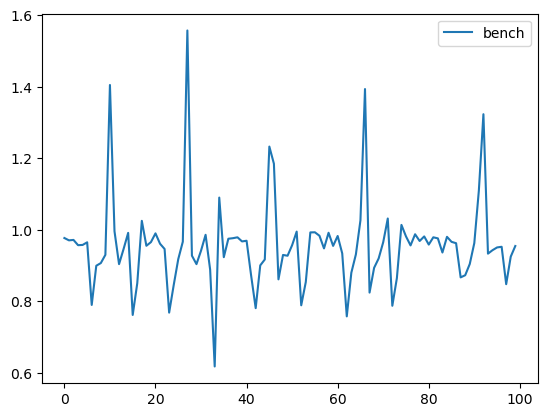

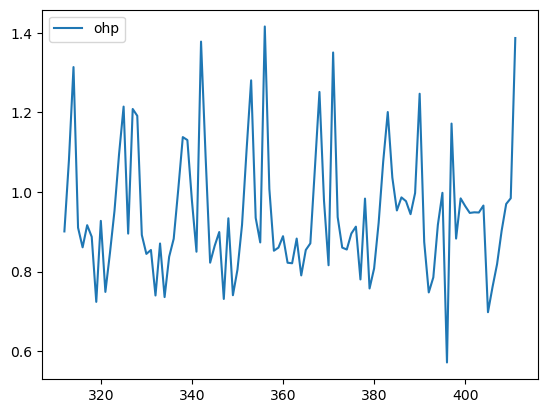

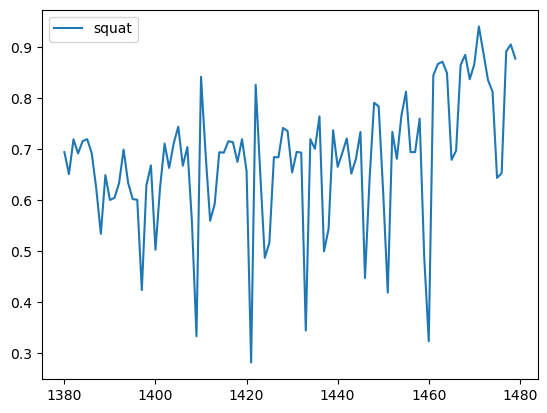

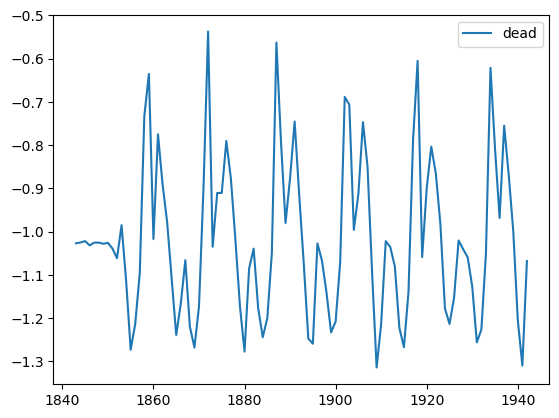

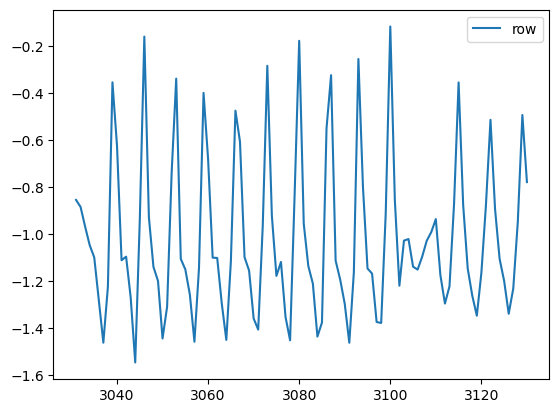

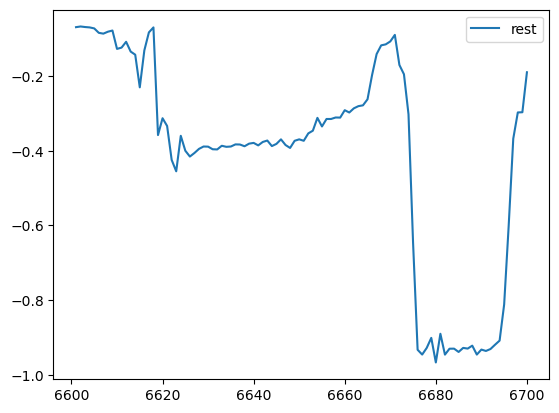

In [13]:
# seeing in details by taking 100 samples

for exercise in temp_df['label'].unique():
    subset_df = temp_df[ temp_df['label'] == exercise ]
    fig, ax = plt.subplots()
    plt.plot(subset_df[:100]['acc_y'], label = exercise)
    plt.legend()
    plt.show()

#### Observations:
* We can notice that there are different pattern for each of the plot.

---

### <font color='blue'> Adjust plot settings

In [15]:
mpl.style.use('seaborn-deep')
mpl.rcParams['figure.figsize'] = (20, 5)
mpl.rcParams['figure.dpi'] = 100 # to extract high resolution

---

### <font color='blue'> Compare medium vs. heavy sets

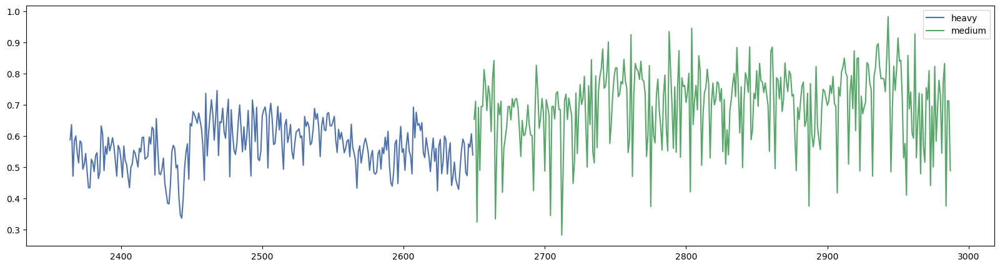

In [16]:
category_df = temp_df.sort_values('participant').sort_values('set').reset_index().query("label == 'squat'").query("participant == 'A'")

fig, ax = plt.subplots()
category_df.groupby(['category'])['acc_y'].plot()
ax.set_label('acc_y')
ax.set_label('samples')
plt.legend()
# **observations** : When the person A is doing the squat exercise with heavy weights have less frequency and with medium weights have more frequency in accerator y-axis
# a person can lift up and down medium weight fast then heavy weights 


---

### <font color='blue'> Compare participants

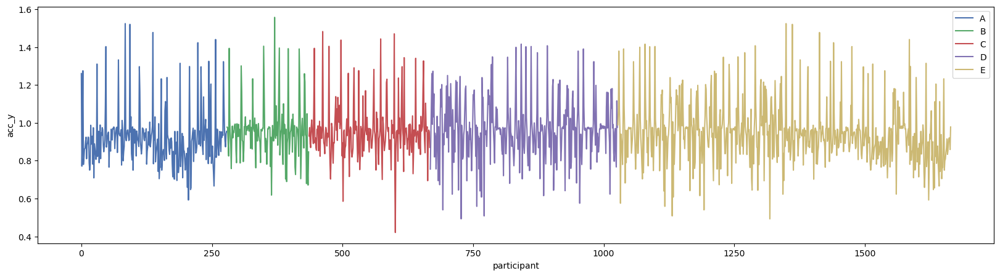

In [17]:
participant_df = temp_df.query('label == "bench"').sort_values('participant').reset_index()

fig, ax = plt.subplots()
participant_df.groupby('participant')['acc_y'].plot()
ax.set_xlabel('participant')
ax.set_ylabel('acc_y')
plt.legend()

---

### <font color='blue'> Plot multiple axis

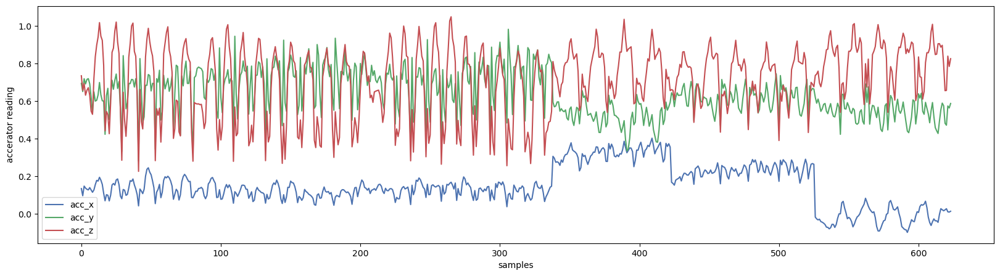

In [18]:
exercise = 'squat'
participant = 'A'
all_axis_df = df.query(f'label == "{exercise}"').query(f'participant == "{participant}"').reset_index()

fig, ax = plt.subplots()
all_axis_df[['acc_x', 'acc_y', 'acc_z']].plot(ax = ax)
ax.set_xlabel('samples')
ax.set_ylabel('accerator reading')
plt.legend()

---

### <font color='blue'> Create a loop to plot all combinations per sensor

C:\Users\darsh\AppData\Local\Temp\ipykernel_27276\2191967568.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


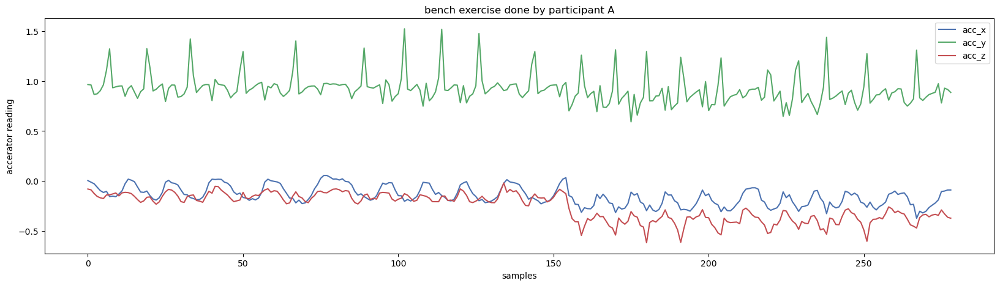

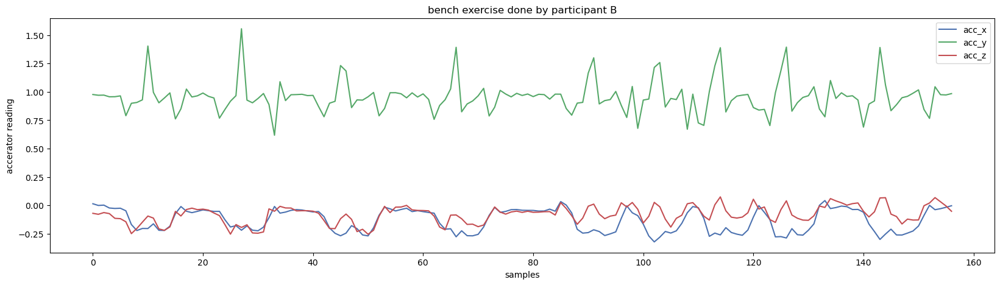

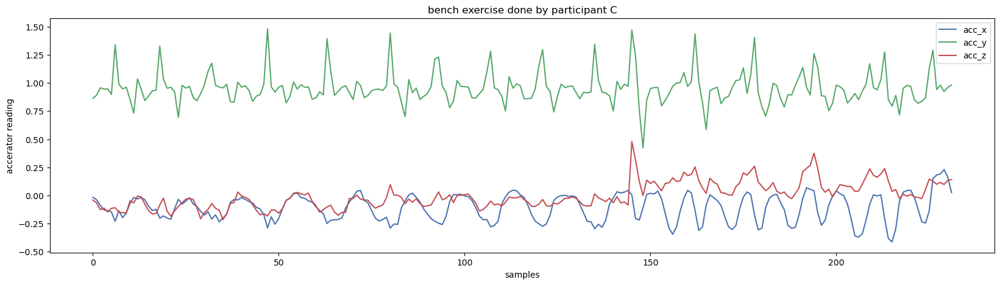

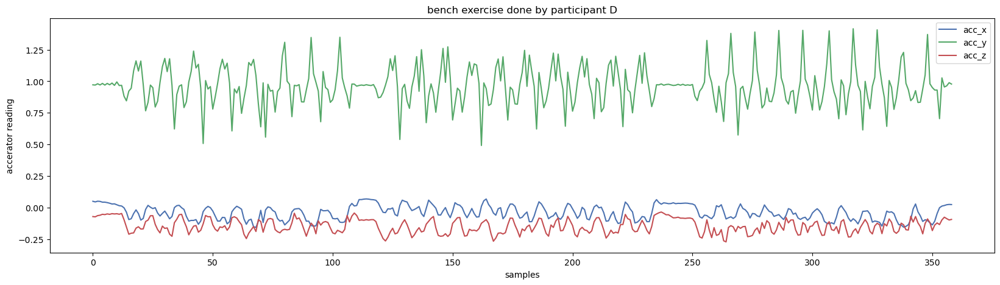

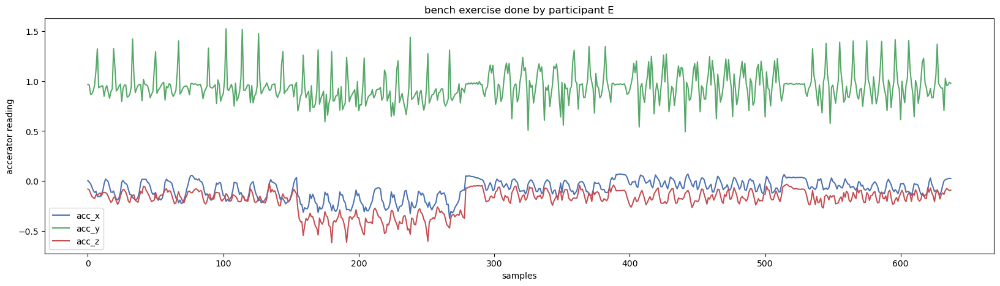

...

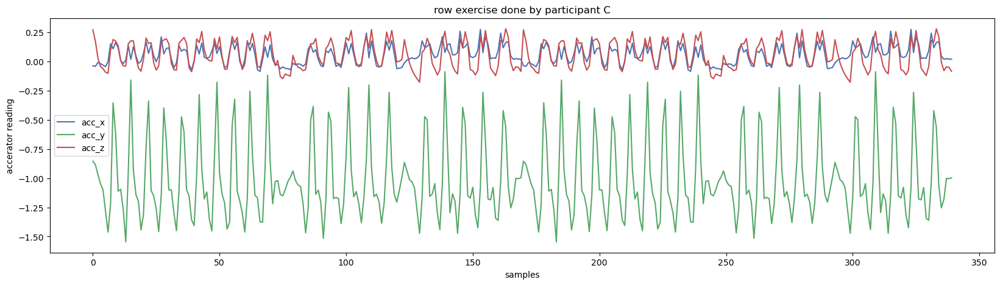

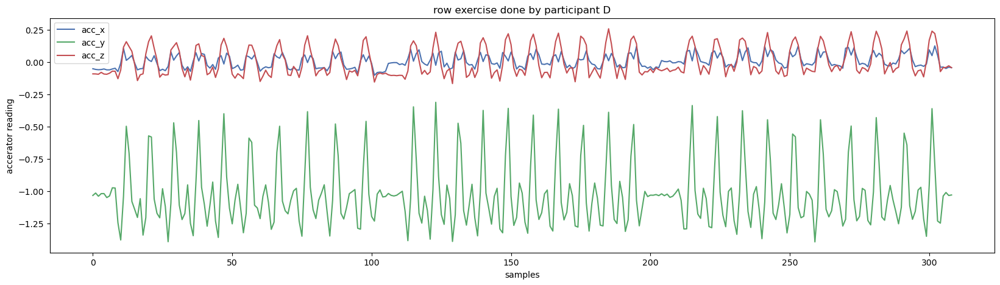

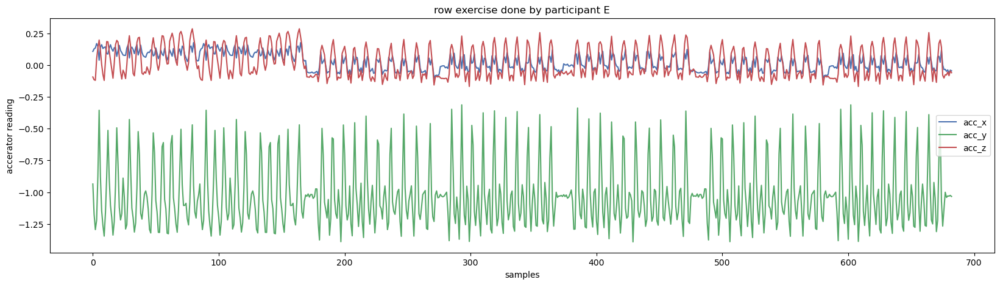

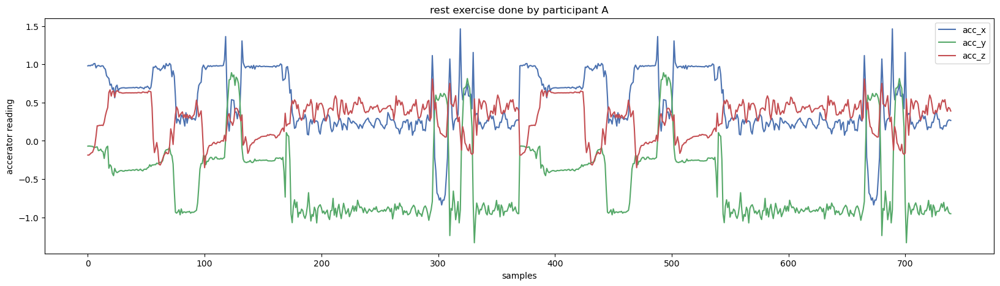

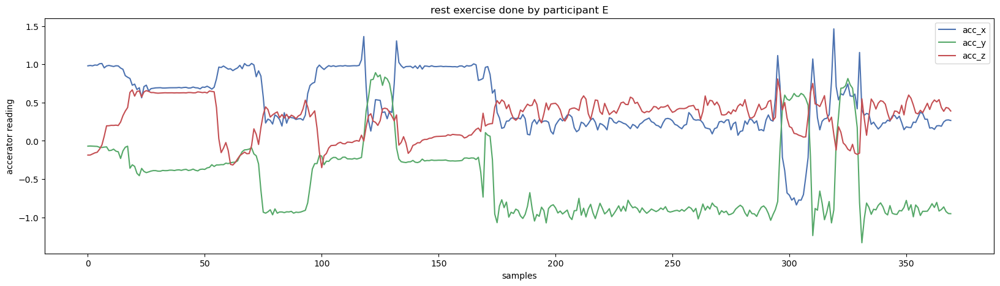

In [19]:
exercises = df['label'].unique()
participants = df['participant'].sort_values().unique()

# for accerator 
for exercise in exercises:
    for participant in participants:
        all_axis_df = (
            df.query(f'label == "{exercise}"')
            .query(f'participant == "{participant}"')
            .reset_index()
        )
        
        if len(all_axis_df) > 0 :    # to avoid the empty plots
            fig, ax = plt.subplots()
            all_axis_df[['acc_x', 'acc_y', 'acc_z']].plot(ax = ax)
            ax.set_xlabel('samples')
            ax.set_ylabel('accerator reading')
            plt.title(f"{exercise} exercise done by participant {participant}")
            plt.legend()   

C:\Users\darsh\AppData\Local\Temp\ipykernel_27276\3440832668.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


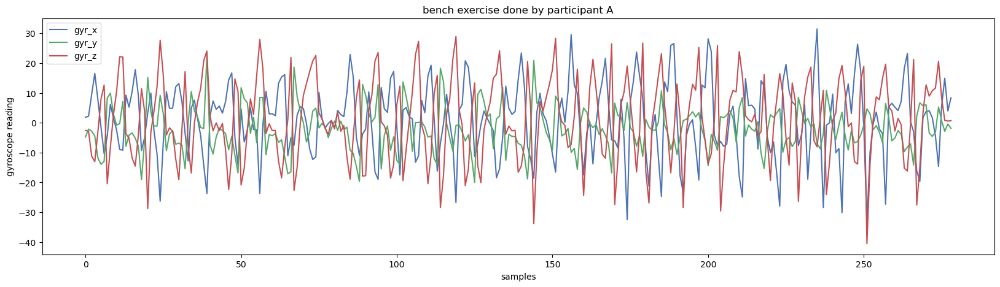

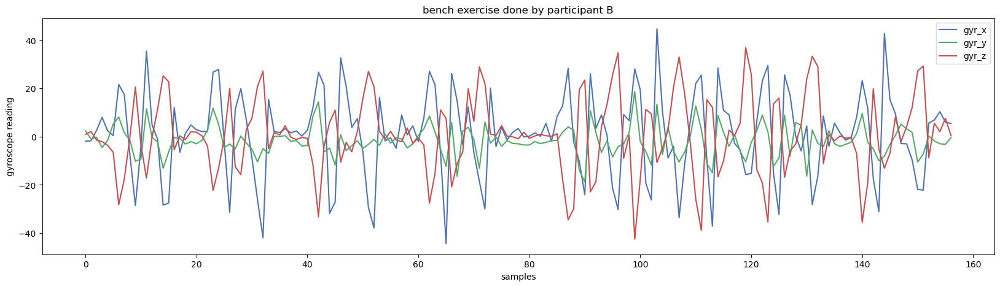

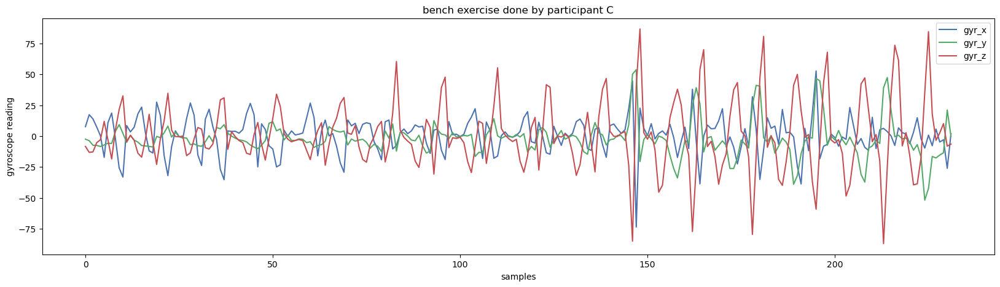

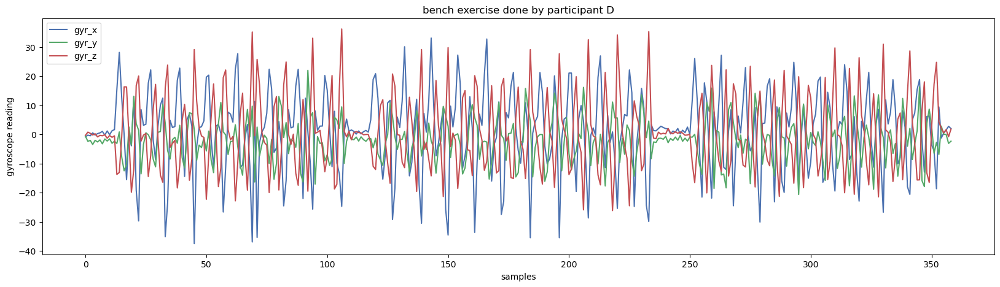

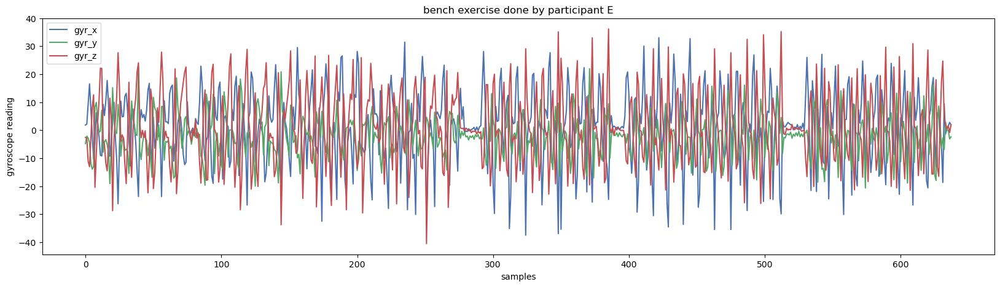

...

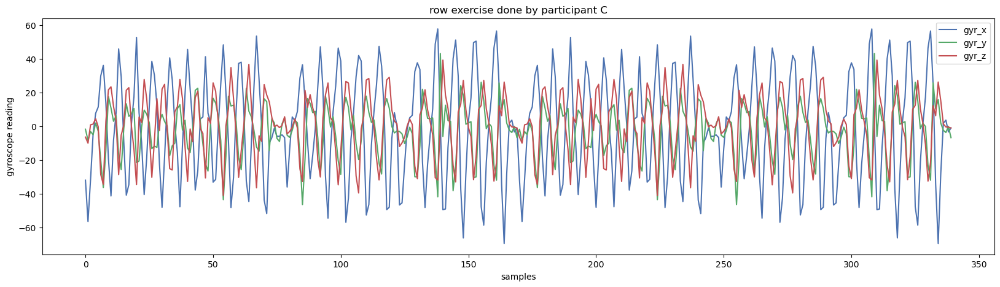

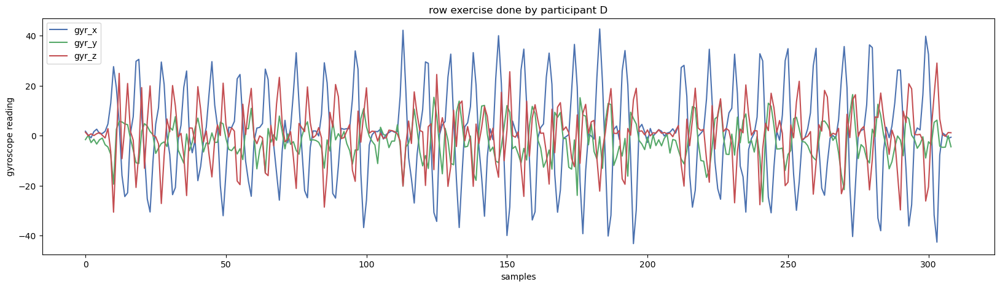

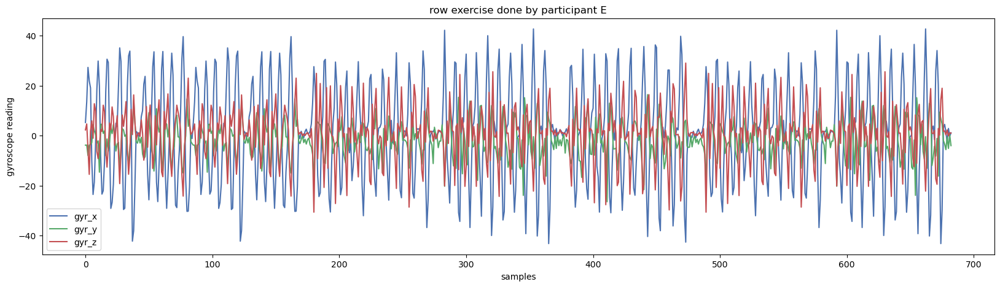

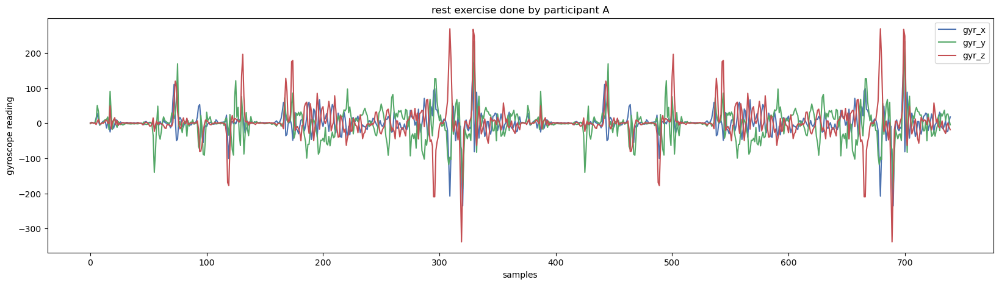

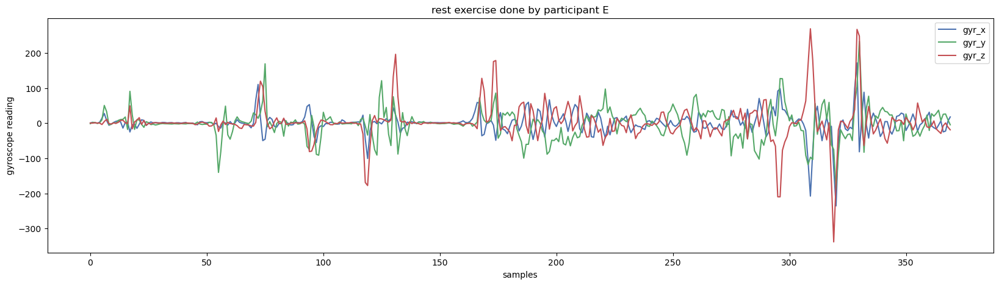

In [20]:
for exercise in exercises:
    for participant in participants:
        all_axis_df = (
            df.query(f'label == "{exercise}"')
            .query(f'participant == "{participant}"')
            .reset_index()
        )
        
        if len(all_axis_df) > 0 :    # to avoid the empty plots
            fig, ax = plt.subplots()
            all_axis_df[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax = ax)
            ax.set_xlabel('samples')
            ax.set_ylabel('gyroscope reading')
            plt.title(f"{exercise} exercise done by participant {participant}")
            plt.legend()

---

### <font color='blue'> Combine plots in one figure

Text(0, 0.5, 'gyroscope reading')

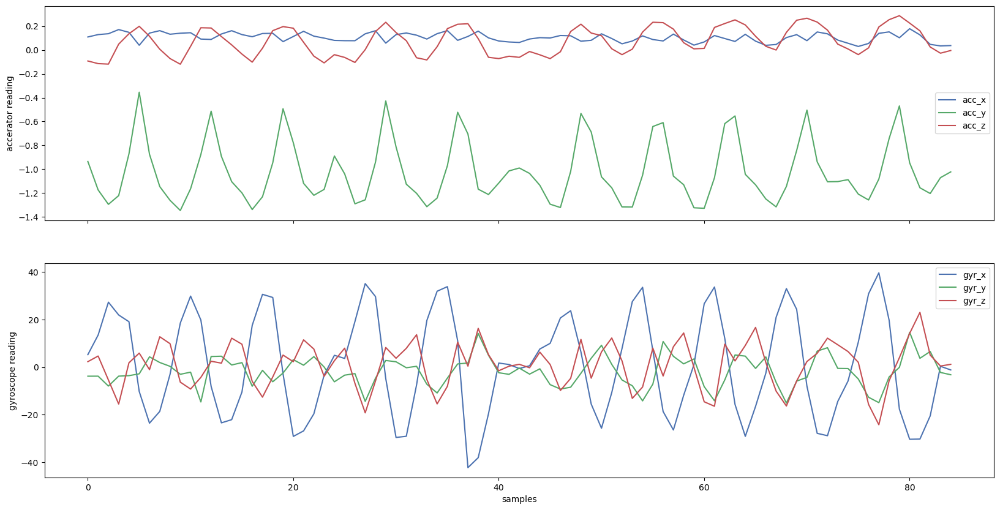

In [21]:
exercise = 'row'
participant = 'A'
combined_plot_df = (
    df.query(f'label == "{exercise}"')
    .query(f'participant == "{participant}"')
    .reset_index()
)

fig, ax = plt.subplots(nrows = 2, sharex = True, figsize = (20, 10))
combined_plot_df[['acc_x', 'acc_y', 'acc_z']].plot(ax = ax[0])
combined_plot_df[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax = ax[1])

ax[1].set_xlabel('samples')
ax[0].set_ylabel('accerator reading')
ax[1].set_ylabel('gyroscope reading')

---

### <font color='blue'> Loop over all combinations and export for both sensors

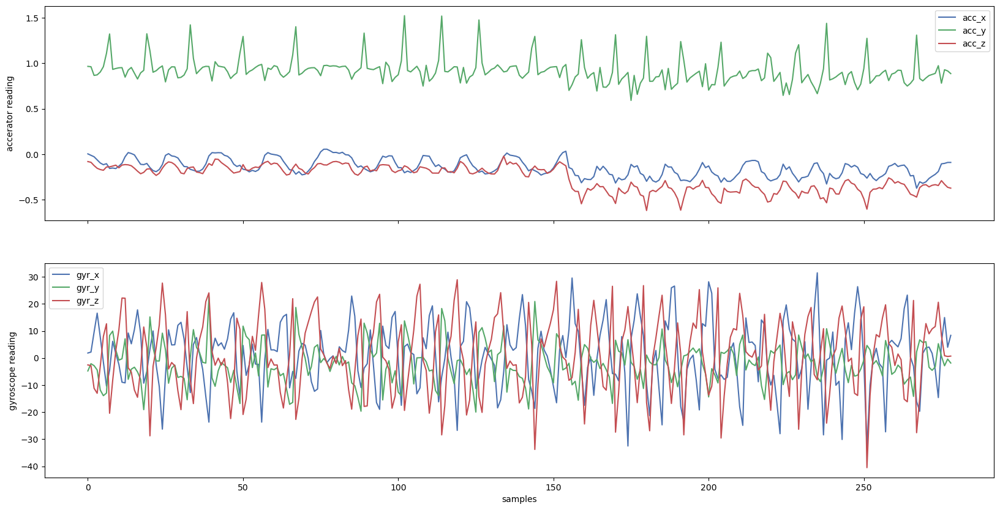

----------------------


<Figure size 2000x500 with 0 Axes>

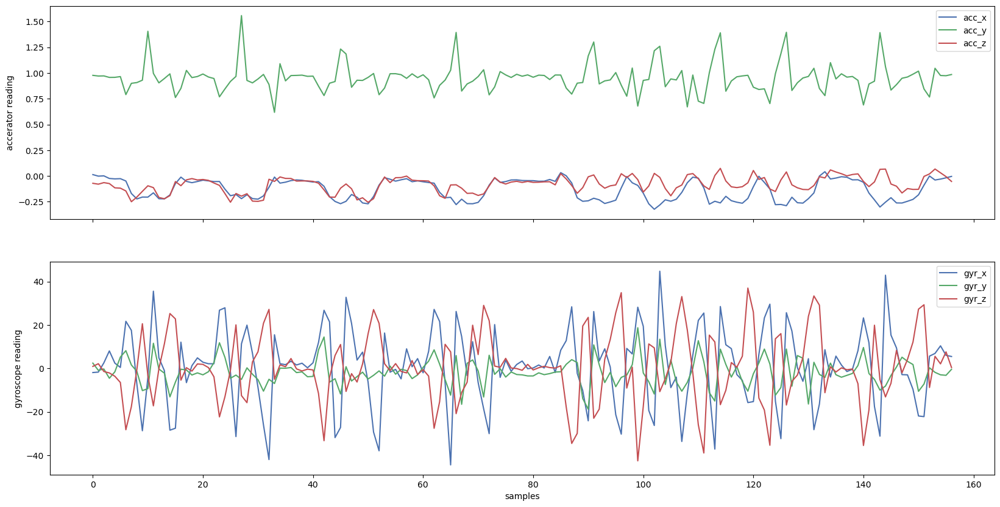

----------------------


<Figure size 2000x500 with 0 Axes>

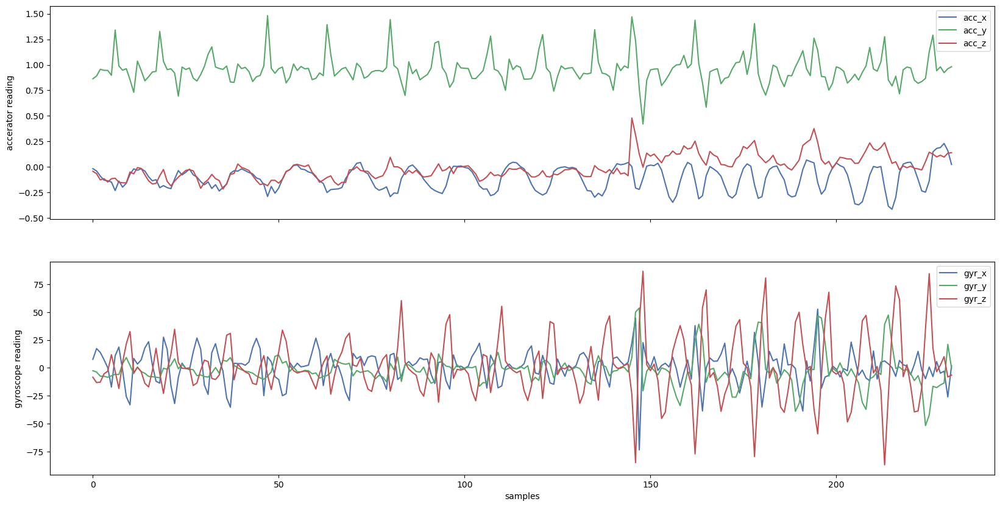

----------------------


<Figure size 2000x500 with 0 Axes>

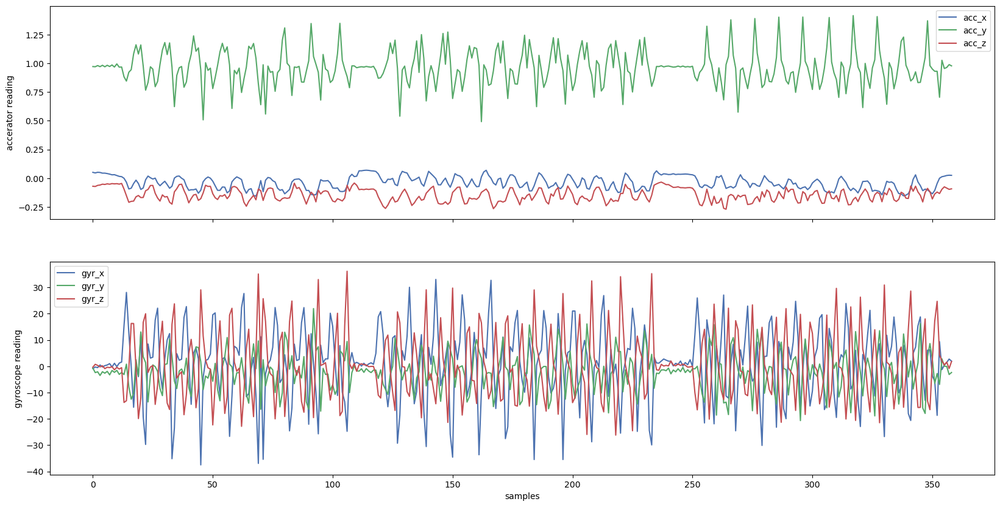

----------------------


<Figure size 2000x500 with 0 Axes>

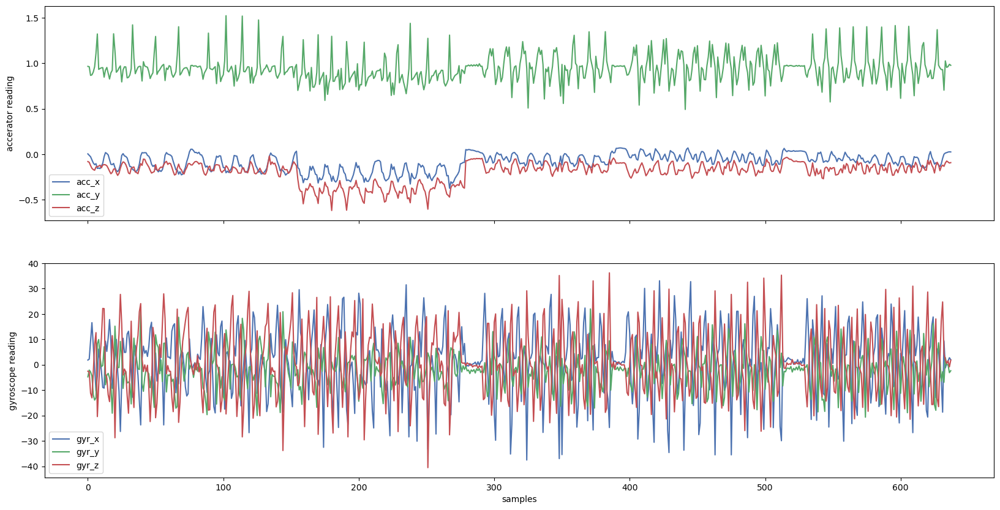

----------------------


<Figure size 2000x500 with 0 Axes>

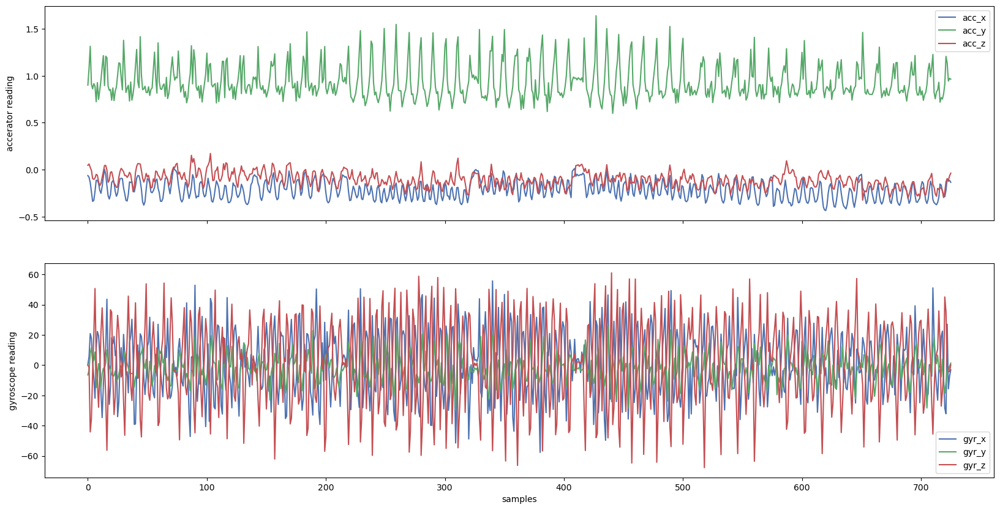

----------------------


<Figure size 2000x500 with 0 Axes>

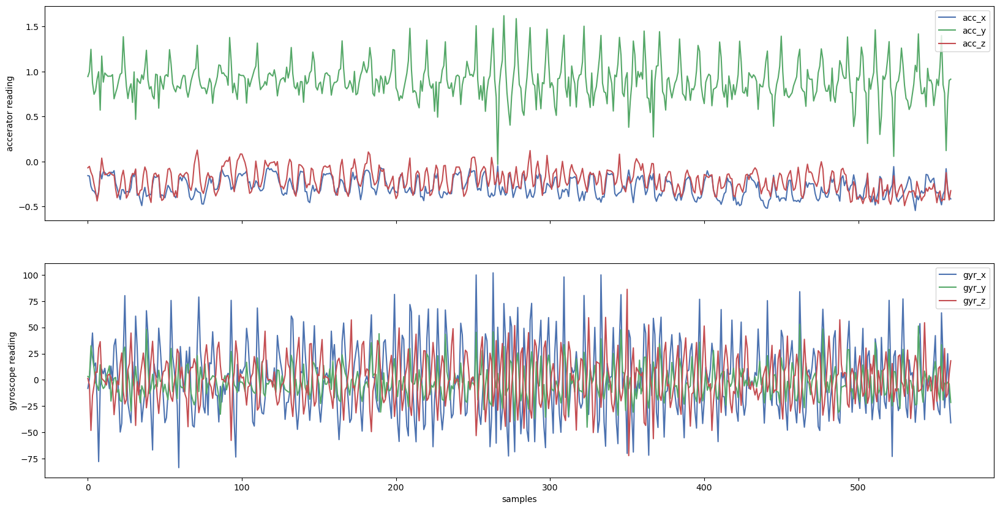

----------------------


<Figure size 2000x500 with 0 Axes>

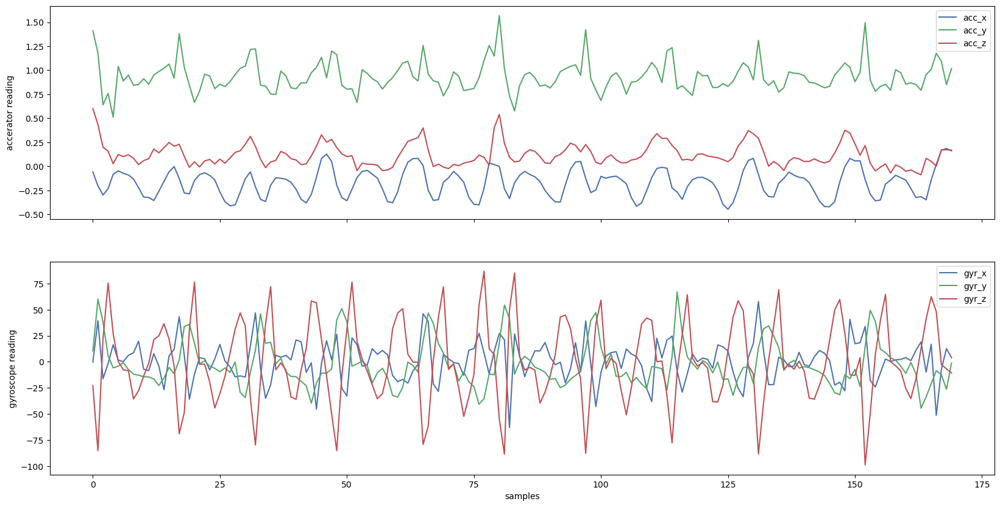

----------------------


<Figure size 2000x500 with 0 Axes>

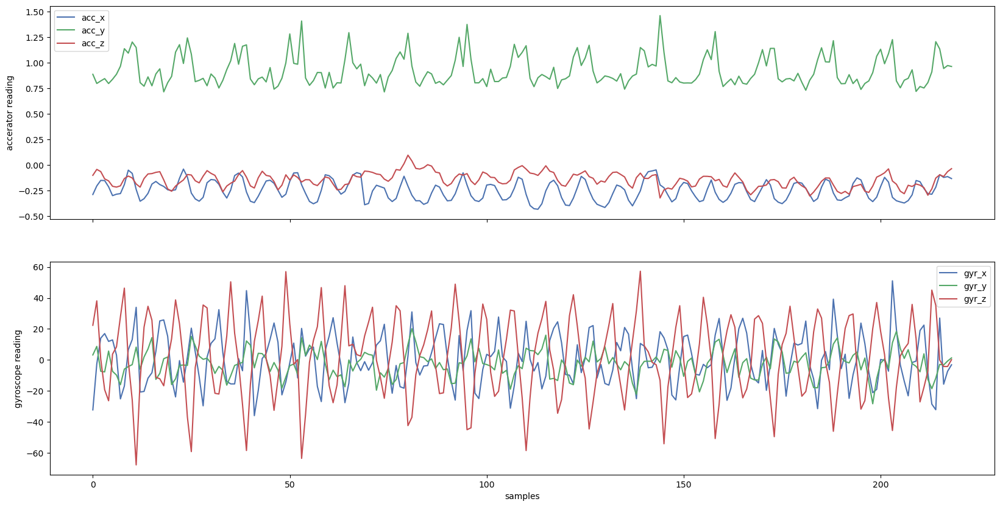

----------------------


<Figure size 2000x500 with 0 Axes>

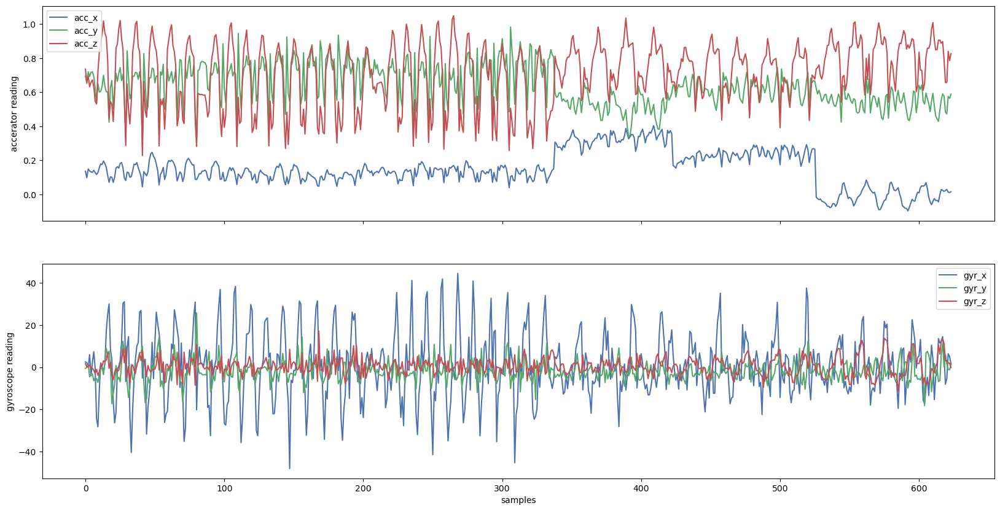

----------------------


<Figure size 2000x500 with 0 Axes>

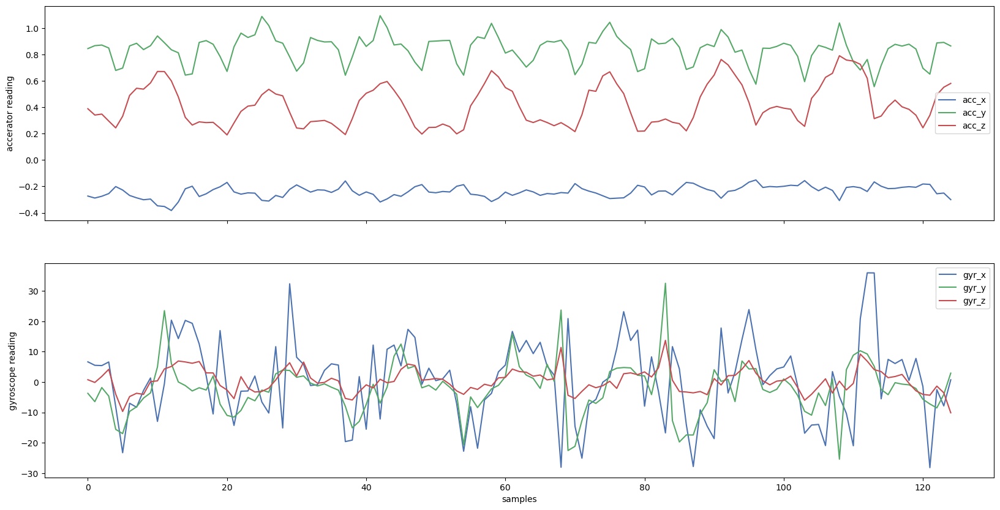

----------------------


<Figure size 2000x500 with 0 Axes>

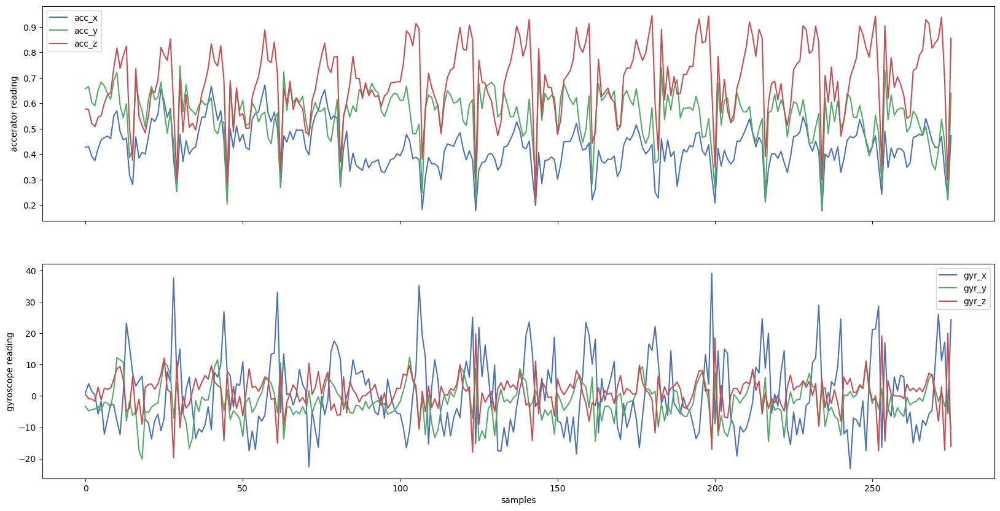

----------------------


<Figure size 2000x500 with 0 Axes>

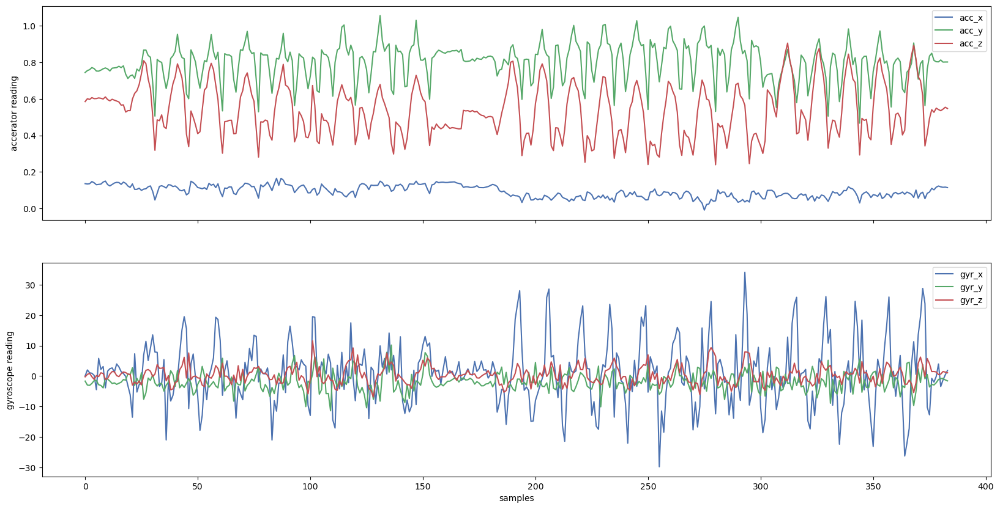

----------------------


<Figure size 2000x500 with 0 Axes>

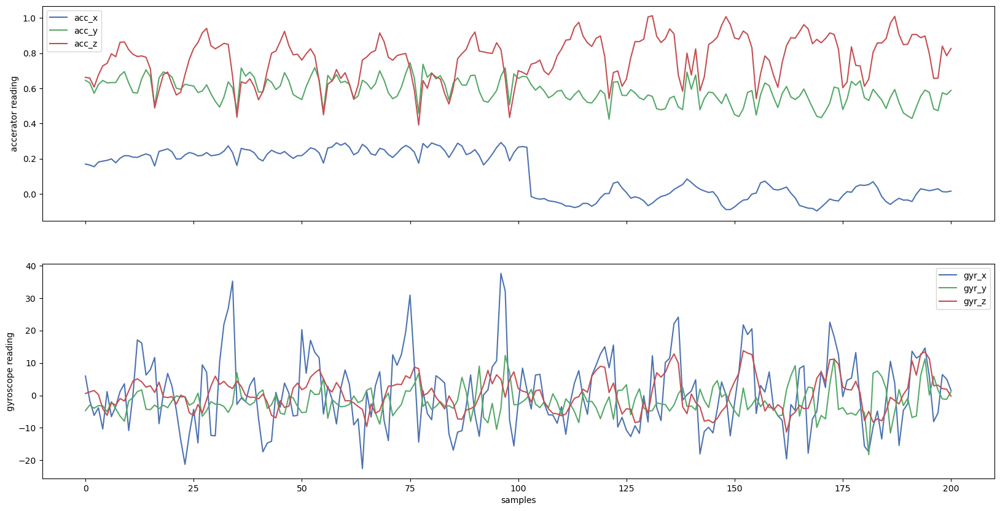

----------------------


<Figure size 2000x500 with 0 Axes>

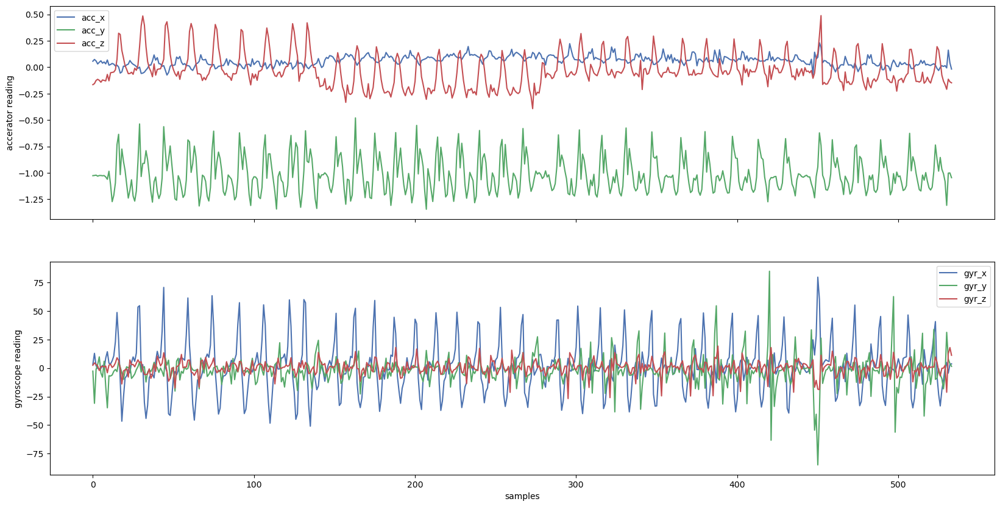

----------------------


<Figure size 2000x500 with 0 Axes>

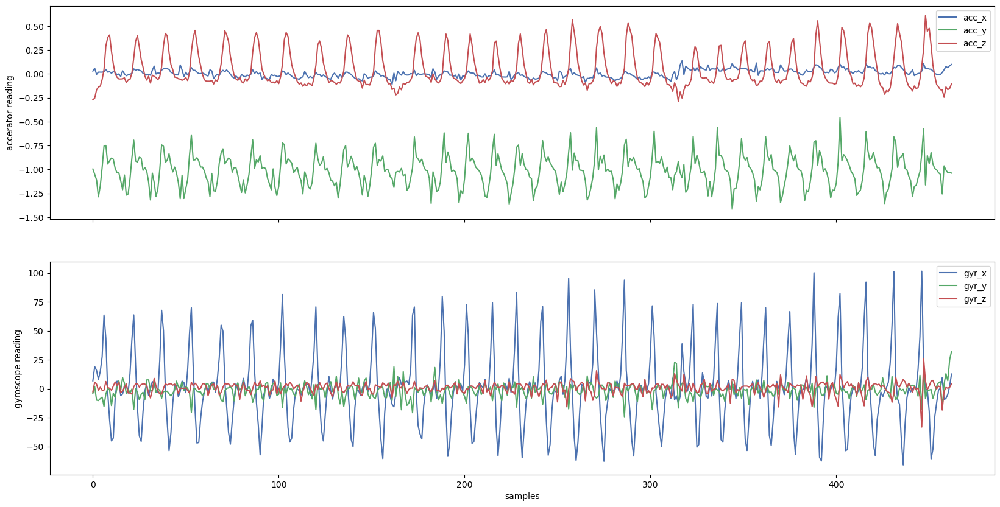

----------------------


<Figure size 2000x500 with 0 Axes>

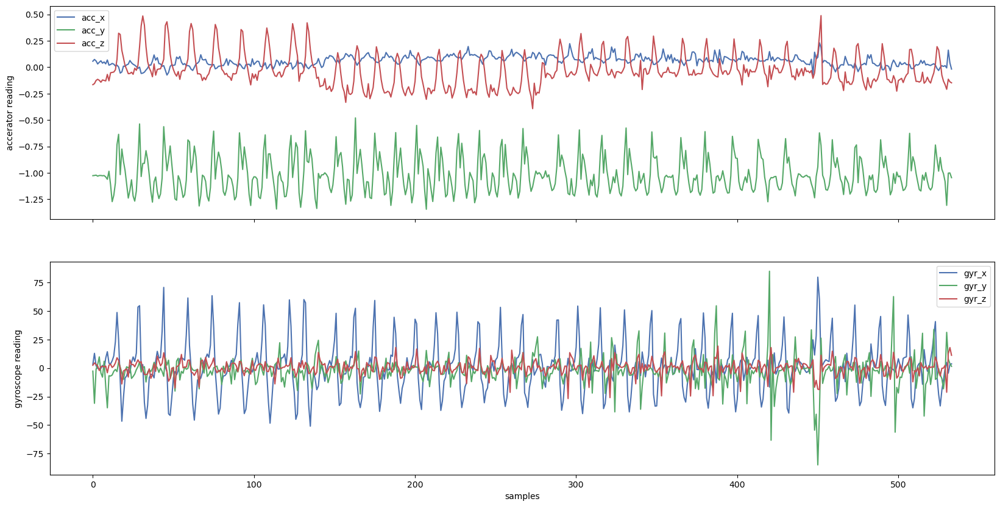

----------------------


<Figure size 2000x500 with 0 Axes>

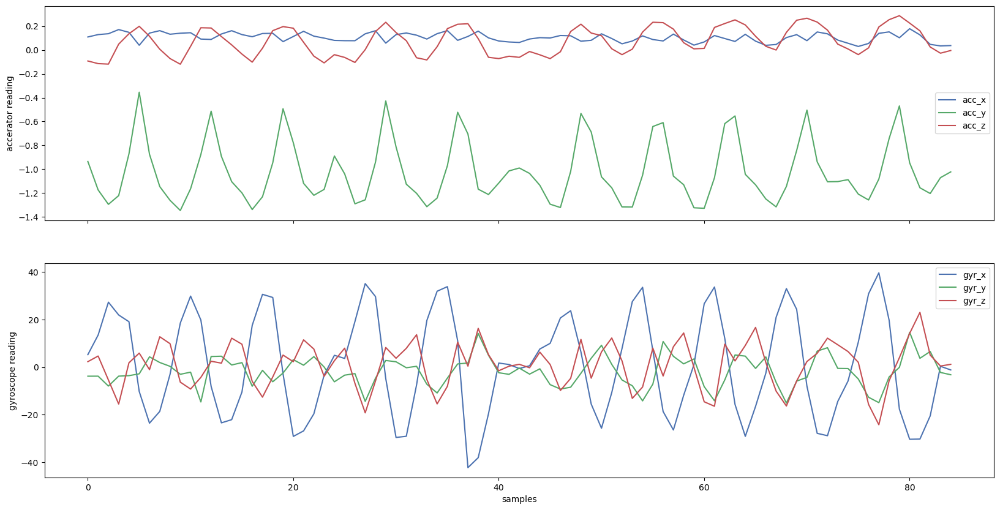

----------------------


<Figure size 2000x500 with 0 Axes>

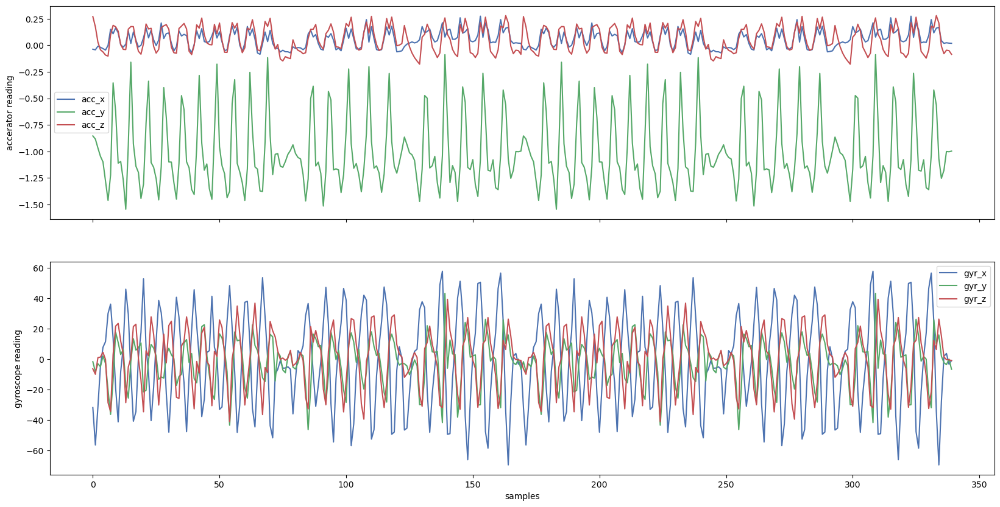

----------------------


<Figure size 2000x500 with 0 Axes>

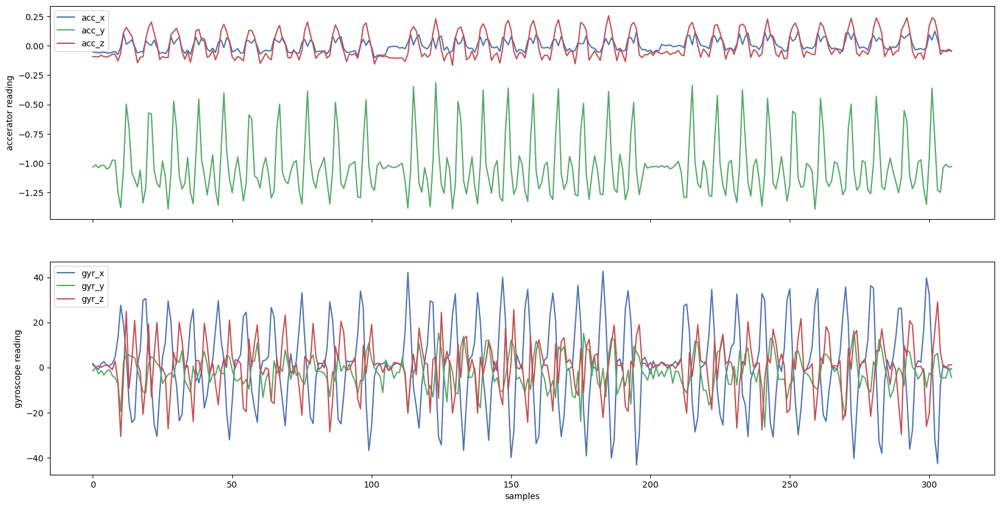

----------------------


<Figure size 2000x500 with 0 Axes>

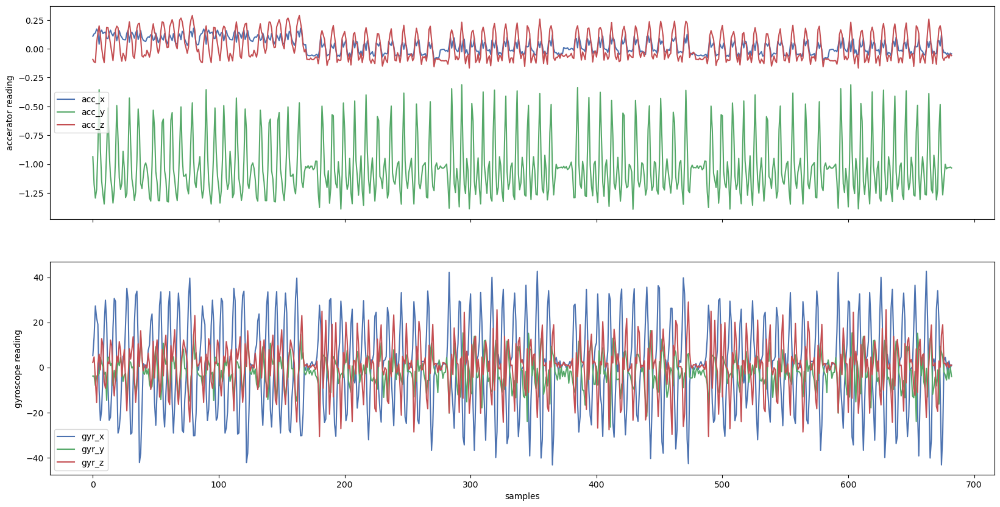

----------------------


<Figure size 2000x500 with 0 Axes>

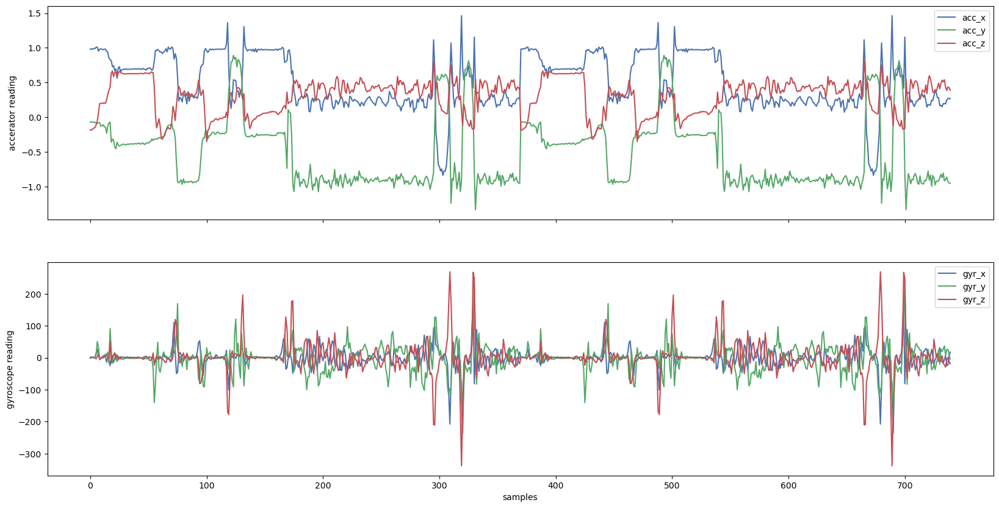

----------------------


<Figure size 2000x500 with 0 Axes>

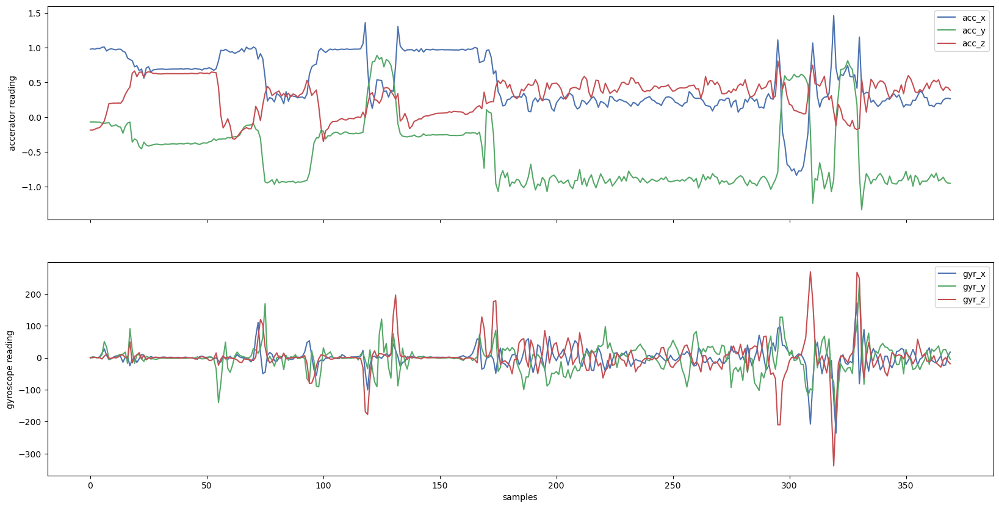

----------------------


<Figure size 2000x500 with 0 Axes>

In [24]:

exercises = df['label'].unique()
participants = df['participant'].sort_values().unique()

path = '../../reports/figures/'
if not os.path.exists(path):
    os.makedirs(path)
    
for exercise in exercises:
    for participant in participants:
        combined_plot_df = (
            df.query(f'label == "{exercise}"')
            .query(f'participant == "{participant}"')
            .reset_index()
        )
        
        if len(combined_plot_df) > 0 :    # to avoid the empty plots
            fig, ax = plt.subplots(nrows = 2, sharex = True, figsize = (20, 10))
            combined_plot_df[['acc_x', 'acc_y', 'acc_z']].plot(ax = ax[0])
            combined_plot_df[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax = ax[1])

            ax[1].set_xlabel('samples')
            ax[0].set_ylabel('accerator reading')
            ax[1].set_ylabel('gyroscope reading')  
            plt.show()
            print('----------------------')
            plt.savefig(f'../../reports/figures/{exercise.title()}({participant}).png')

---